# Menyelesaikan Permasalahan Institusi Pendidikan
- Nama: Wildan Ramdhani
- Email: wilramdhani72@gmail.com
- Id Dicoding: wilramdhani

# Business Understanding

Institusi pendidikan tinggi menghadapi tantangan signifikan terkait tingkat putus sekolah (dropout), mendaftar dan keberhasilan akademik mahasiswa. Tingginya angka dropout tidak hanya berdampak pada reputasi institusi tetapi juga pada sumber daya yang diinvestasikan dalam pendidikan mahasiswa. Dengan memahami faktor-faktor yang mempengaruhi keputusan mahasiswa untuk tetap melanjutkan atau menghentikan studi mereka, institusi dapat mengimplementasikan strategi yang lebih efektif untuk meningkatkan retensi dan keberhasilan akademik.

## Problem Statement

Meskipun institusi pendidikan tinggi menyediakan berbagai program studi, terdapat variasi signifikan dalam tingkat retensi dan keberhasilan akademik mahasiswa di berbagai program tersebut. Tingginya tingkat putus sekolah dan rendahnya kinerja akademik di beberapa program studi mengindikasikan adanya faktor-faktor yang belum sepenuhnya dipahami atau ditangani. Oleh karena itu, diperlukan model klasifikasi yang dapat memprediksi tingkat putus sekolah dan keberhasilan akademik mahasiswa berdasarkan data pendaftaran dan kinerja akademik awal mereka.

## Business Questions

Berdasarkan Business Understanding & Problem statement yang ada berikut ini adalah pertanyaan bisnis yang dapat dibuat:
1. Faktor apa saja yang paling signifikan mempengaruhi keputusan mahasiswa untuk dropout di institusi ini?
2. Seberapa akurat model klasifikasi dalam memprediksi dropout dan keberhasilan akademik mahasiswa?
3. Langkah-langkah apa yang dapat diambil oleh pihak institusi untuk menurunkan tingkat dropout berdasarkan prediksi model?

## Goals

Proyek ini bertujuan untuk Membangun dan mengimplementasikan model klasifikasi yang efektif untuk memprediksi tingkat putus sekolah dan keberhasilan akademik mahasiswa, sehingga institusi dapat mengambil tindakan proaktif untuk meningkatkan retensi dan kinerja akademik. tujuan proyek ini meliputi:
1. **Identifikasi Faktor Kunci**: Mengidentifikasi dan menganalisis faktor-faktor demografi, sosial-ekonomi, dan akademik yang paling berpengaruh terhadap keputusan dropout dan keberhasilan akademik mahasiswa.
2. **Pengembangan Model Prediksi**: Mengembangkan model klasifikasi dengan akurasi tinggi yang dapat memprediksi kemungkinan dropout dan tingkat keberhasilan akademik mahasiswa.


# Import Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import joblib
from google.colab import files
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.inspection import permutation_importance
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, roc_auc_score, roc_curve
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import GridSearchCV
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.preprocessing import StandardScaler


# Load Data & Data Understanding

In [2]:
#load datasets
base_path_hour = 'https://raw.githubusercontent.com/dicodingacademy/dicoding_dataset/main/students_performance/data.csv'

df = pd.read_csv(base_path_hour, delimiter=';', on_bad_lines='skip')

# Menampilkan 5 baris data pertama
df.head()

,Marital_status,Application_mode,Application_order,Course,Daytime_evening_attendance,Previous_qualification,Previous_qualification_grade,Nacionality,Mothers_qualification,Fathers_qualification,...,Curricular_units_2nd_sem_credited,Curricular_units_2nd_sem_enrolled,Curricular_units_2nd_sem_evaluations,Curricular_units_2nd_sem_approved,Curricular_units_2nd_sem_grade,Curricular_units_2nd_sem_without_evaluations,Unemployment_rate,Inflation_rate,GDP,Status
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,Graduate


In [3]:
print(f"the number of columns of the datasets: {df.shape[1]}")
print(f"the number of rows of the datasets: {df.shape[0]}")

the number of columns of the datasets: 37
the number of rows of the datasets: 4424


In [4]:
# Menampilkan informasi setiap kolom pada data
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4424 entries, 0 to 4423
Data columns (total 37 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   Marital_status                                4424 non-null   int64  
 1   Application_mode                              4424 non-null   int64  
 2   Application_order                             4424 non-null   int64  
 3   Course                                        4424 non-null   int64  
 4   Daytime_evening_attendance                    4424 non-null   int64  
 5   Previous_qualification                        4424 non-null   int64  
 6   Previous_qualification_grade                  4424 non-null   float64
 7   Nacionality                                   4424 non-null   int64  
 8   Mothers_qualification                         4424 non-null   int64  
 9   Fathers_qualification                         4424 non-null   i

Dataset yang digunakan dalam proyek ini adalah dataset yang bersumber dari github dengan tautan berikut: https://github.com/dicodingacademy/dicoding_dataset/blob/main/students_performance/data.csv

Detail kolom dataset:

- **Marital status**: The marital status of the student.
-**Application mode**: The method of application used by the student.
- **Application order**: The order in which the student applied.
- **Course**: The course taken by the student.
- **Daytime/evening attendance**: Whether the student attends classes during the day or in the evening.
- **Previous qualification**: The qualification obtained by the student before enrolling in higher education.
-**Previous qualification (grade)**: Grade of previous qualification (between 0 and 200)
- **Nacionality**: The nationality of the student.
- **Mother's qualification**: The qualification of the student's mother.
- **Father's qualification**: The qualification of the student's father.
- **Mother's occupation**: The occupation of the student's mother.
- **Father's occupation**: The occupation of the student's father.
- **Admission grade**: Admission grade (between 0 and 200)
- **Displaced**: Whether the student is a displaced person.
- **Educational special needs**: Whether the student has any special educational needs.
- **Debtor**: Whether the student is a debtor.
- **Gender**: The gender of the student.
- **Scholarship holder**: Whether the student is a scholarship holder.
- **Age at enrollment**: The age of the student at the time of enrollment.
- **International**: Whether the student is an international student.
- **Curricular units 1st sem (credited)**: The number of curricular units credited by the student in the first semester.
- **Curricular units 1st sem (enrolled)**: The number of curricular units enrolled by the student in the first semester.
- **Curricular units 1st sem (evaluations)**: The number of curricular units evaluated by the student in the first semester.
- **Curricular units 1st sem (approved)**: The number of curricular units approved by the student in the first semester.

In [5]:
# Menampilkan informasi apakah data memiliki missing value
print(f"Data missing: {df.isnull().sum().sum()}")
df.isnull().sum()

Data missing: 0


,0
Marital_status,0
Application_mode,0
Application_order,0
Course,0
Daytime_evening_attendance,0
Previous_qualification,0
Previous_qualification_grade,0
Nacionality,0
Mothers_qualification,0
Fathers_qualification,0


Pada Dataset yang dimiliki tidak ada indikasi missing value pada datanya sehingga kita bisa melanjutkan ke tahapan selanjutnya

In [6]:
# Mendeteksi Duplikasi Data
df.duplicated().sum()

np.int64(0)

Pada Dataset yang dimiliki juga tidak ada indikasi duplikasi data pada datanya sehingga kita bisa melanjutkan ke tahapan selanjutnya

#Data Preparation

In [7]:
df.describe()

,Marital_status,Application_mode,Application_order,Course,Daytime_evening_attendance,Previous_qualification,Previous_qualification_grade,Nacionality,Mothers_qualification,Fathers_qualification,...,Curricular_units_1st_sem_without_evaluations,Curricular_units_2nd_sem_credited,Curricular_units_2nd_sem_enrolled,Curricular_units_2nd_sem_evaluations,Curricular_units_2nd_sem_approved,Curricular_units_2nd_sem_grade,Curricular_units_2nd_sem_without_evaluations,Unemployment_rate,Inflation_rate,GDP
count,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,...,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000
mean,1.178571,18.669078,1.727848,8856.642631,0.890823,4.577758,132.613314,1.873192,19.561935,22.275316,...,0.137658,0.541817,6.232143,8.063291,4.435805,10.230206,0.150316,11.566139,1.228029,0.001969
std,0.605747,17.484682,1.313793,2063.566416,0.311897,10.216592,13.188332,6.914514,15.603186,15.343108,...,0.690880,1.918546,2.195951,3.947951,3.014764,5.210808,0.753774,2.663850,1.382711,2.269935
min,1.000000,1.000000,0.000000,33.000000,0.000000,1.000000,95.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.600000,-0.800000,-4.060000
25%,1.000000,1.000000,1.000000,9085.000000,1.000000,1.000000,125.000000,1.000000,2.000000,3.000000,...,0.000000,0.000000,5.000000,6.000000,2.000000,10.750000,0.000000,9.400000,0.300000,-1.700000
50%,1.000000,17.000000,1.000000,9238.000000,1.000000,1.000000,133.100000,1.000000,19.000000,19.000000,...,0.000000,0.000000,6.000000,8.000000,5.000000,12.200000,0.000000,11.100000,1.400000,0.320000
75%,1.000000,39.000000,2.000000,9556.000000,1.000000,1.000000,140.000000,1.000000,37.000000,37.000000,...,0.000000,0.000000,7.000000,10.000000,6.000000,13.333333,0.000000,13.900000,2.600000,1.790000
max,6.000000,57.000000,9.000000,9991.000000,1.000000,43.000000,190.000000,109.000000,44.000000,44.000000,...,12.000000,19.000000,23.000000,33.000000,20.000000,18.571429,12.000000,16.200000,3.700000,3.510000


In [8]:
df.describe(include='object')

,Status
count,4424
unique,3
top,Graduate
freq,2209


Sejauh ini, berdasarkan pengamatan statistik ringkasan dari kolom numerik menggunakan `.describe()` pada data yang dimiliki, tidak ada data yang anomali atau tidak normal yang teramati. Untuk data kategorikal (data target) memiliki 3 value unique, untuk itu kita bisa melakukan pemerikasaan data apakah data target imbalance atau tidak

Status
Graduate    2209
Dropout     1421
Enrolled     794
Name: count, dtype: int64


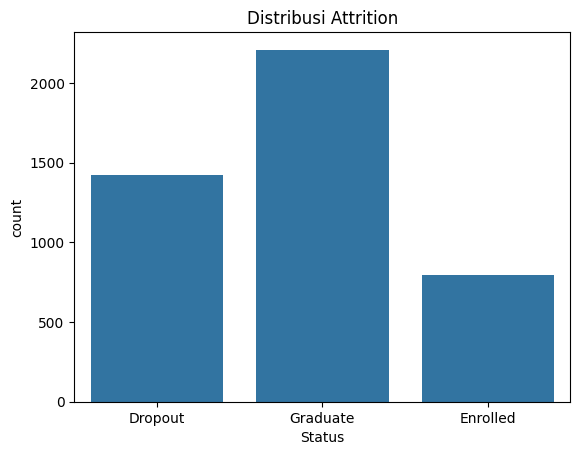

In [9]:
# Memeriksa distribusi target
print(df['Status'].value_counts())

# Visualisasi distribusi target
sns.countplot(x=df['Status'])
plt.title('Distribusi Attrition')
plt.show()

Dari hasil visualisasi yang diatas, dapat dilihat bahwa data target memiliki indikasi sedikit imbalance data pada data target yang kita miliki ini, untuk itu pada spliting data nantinya kita akan lakukan balancing data agar meningkatkan performa pada model yang akan dibuat nantinya

In [10]:
# Menambah beberapa kolom
df['Economic_pressure_score'] = df['Unemployment_rate'] + df['Inflation_rate'] - df['GDP']

df['Total_enrolled_units'] = df['Curricular_units_1st_sem_enrolled'] + df['Curricular_units_2nd_sem_enrolled']
df['Total_approved_unit'] = df['Curricular_units_1st_sem_approved'] + df['Curricular_units_2nd_sem_approved']
df['Approval_rate'] = np.where( df['Total_enrolled_units'] > 0, (df['Total_approved_unit'] / df['Total_enrolled_units']) * 100, 0)

df['Average_grade'] = (df['Curricular_units_1st_sem_grade'] + df['Curricular_units_2nd_sem_grade']) / 2
df['Average_grade'] = df[['Curricular_units_1st_sem_grade', 'Curricular_units_2nd_sem_grade']].mean(axis=1, skipna=True)

In [11]:
# Check data
print(f"Data missing: {df.isnull().sum().sum()}")

Data missing: 0


Menambah beberapa kolom untuk menyediakan fitur tambahan pada model klasifikasi prediksi dropout dan keberhasilan akademik mahasiswa

In [12]:
df.to_csv('data_students.csv', index=False)
files.download('data_students.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Exploration Data Analysis

In [13]:
# Membuat function untuk visualisasi facetgrid
def viz(df,types):
    num = df
    f = pd.melt(num, value_vars=num)
    g = sns.FacetGrid(f, col="variable",  col_wrap=3,
                      sharex=False, sharey=False, height = 5)
    g = g.map(types, "value")
    plt.show()
    return (g)

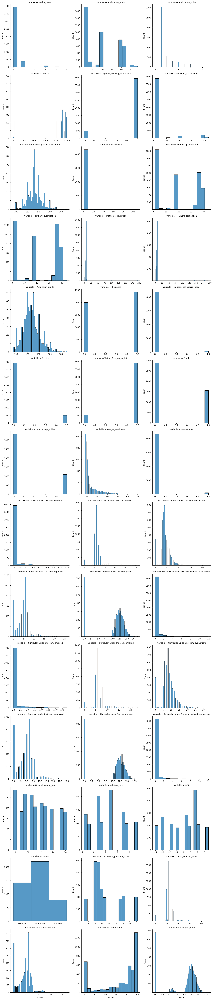

In [14]:
# check distribusi data pada data
viz(df, sns.histplot);

In [15]:
# Melihat skewness dari data untuk mengetahui detail
skew_report = df.skew(numeric_only=True).reset_index()
skew_report.columns = ['columns','skew_score']
skew_report.sort_values('skew_score', ascending  = False)

,columns,skew_score
7,Nacionality,10.703998
14,Educational_special_needs,9.154976
26,Curricular_units_1st_sem_without_evaluations,8.207403
32,Curricular_units_2nd_sem_without_evaluations,7.267701
20,International,6.104830
11,Fathers_occupation,5.395173
10,Mothers_occupation,5.339227
27,Curricular_units_2nd_sem_credited,4.634820
0,Marital_status,4.399764
21,Curricular_units_1st_sem_credited,4.169049


Kolom-kolom dibawah ini memiliki **Extreme Skewed** yang nantinya kita dapat pertimbangkan untuk ditangani untuk dilakukan transform pada kolom tersebut agar terdistribusi normal, berikut adalah kolom-kolomnya: `Nacionality`, `Educational_special_needs`, `Curricular_units_1st_sem_without_evaluations`, `Curricular_units_2nd_sem_without_evaluations`, `International`, `Fathers_occupation`, `Mothers_occupation`, `Curricular_units_2nd_sem_credited`, `Marital_status`, `Curricular_units_1st_sem_credited`

/usr/local/lib/python3.11/dist-packages/seaborn/axisgrid.py:718: UserWarning: Using the boxplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)


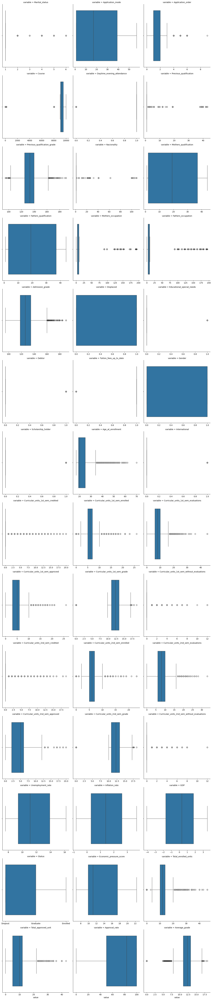

In [16]:
# check outliers plots data pada data day
viz(df, sns.boxplot);

In [17]:
# Membuat function untuk melihat outliers report
def outliers(s):
    iqr = (np.quantile(s, 0.75))-(np.quantile(s, 0.25))
    upper_bound = np.quantile(s, 0.75)+(1.5*iqr)
    lower_bound = np.quantile(s, 0.25)-(1.5*iqr)
    f = []
    for i in s:
        if i > upper_bound:
            f.append(i)
        elif i < lower_bound:
            f.append(i)
    sums = len(f)
    pros = len(f)/len(s)*100
    d = {'IQR':iqr,
         'Upper Bound':upper_bound,
        'Lower Bound':lower_bound,
        'Sum outliers': sums,'percentage outliers':pros}
    d = pd.DataFrame(d.items(),columns = ['sub','values'])
    return(d)

# mencari outliers details
columns_to_plot = df.describe().columns.tolist()
for i in df[columns_to_plot]:
  print(i,'\n', display(outliers(df[i])))

,sub,values
0,IQR,0.000000
1,Upper Bound,1.000000
2,Lower Bound,1.000000
3,Sum outliers,505.000000
4,percentage outliers,11.415009


Marital_status 
 None


,sub,values
0,IQR,38.0
1,Upper Bound,96.0
2,Lower Bound,-56.0
3,Sum outliers,0.0
4,percentage outliers,0.0


Application_mode 
 None


,sub,values
0,IQR,1.000000
1,Upper Bound,3.500000
2,Lower Bound,-0.500000
3,Sum outliers,541.000000
4,percentage outliers,12.228752


Application_order 
 None


,sub,values
0,IQR,471.000000
1,Upper Bound,10262.500000
2,Lower Bound,8378.500000
3,Sum outliers,442.000000
4,percentage outliers,9.990958


Course 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,1.000000
2,Lower Bound,1.000000
3,Sum outliers,483.000000
4,percentage outliers,10.917722


Daytime_evening_attendance 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,1.000000
2,Lower Bound,1.000000
3,Sum outliers,707.000000
4,percentage outliers,15.981013


Previous_qualification 
 None


,sub,values
0,IQR,15.000000
1,Upper Bound,162.500000
2,Lower Bound,102.500000
3,Sum outliers,179.000000
4,percentage outliers,4.046112


Previous_qualification_grade 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,1.000000
2,Lower Bound,1.000000
3,Sum outliers,110.000000
4,percentage outliers,2.486438


Nacionality 
 None


,sub,values
0,IQR,35.0
1,Upper Bound,89.5
2,Lower Bound,-50.5
3,Sum outliers,0.0
4,percentage outliers,0.0


Mothers_qualification 
 None


,sub,values
0,IQR,34.0
1,Upper Bound,88.0
2,Lower Bound,-48.0
3,Sum outliers,0.0
4,percentage outliers,0.0


Fathers_qualification 
 None


,sub,values
0,IQR,5.000000
1,Upper Bound,16.500000
2,Lower Bound,-3.500000
3,Sum outliers,182.000000
4,percentage outliers,4.113924


Mothers_occupation 
 None


,sub,values
0,IQR,5.000000
1,Upper Bound,16.500000
2,Lower Bound,-3.500000
3,Sum outliers,177.000000
4,percentage outliers,4.000904


Fathers_occupation 
 None


,sub,values
0,IQR,16.900000
1,Upper Bound,160.150000
2,Lower Bound,92.550000
3,Sum outliers,86.000000
4,percentage outliers,1.943942


Admission_grade 
 None


,sub,values
0,IQR,1.0
1,Upper Bound,2.5
2,Lower Bound,-1.5
3,Sum outliers,0.0
4,percentage outliers,0.0


Displaced 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,0.000000
2,Lower Bound,0.000000
3,Sum outliers,51.000000
4,percentage outliers,1.152803


Educational_special_needs 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,0.000000
2,Lower Bound,0.000000
3,Sum outliers,503.000000
4,percentage outliers,11.369801


Debtor 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,1.000000
2,Lower Bound,1.000000
3,Sum outliers,528.000000
4,percentage outliers,11.934901


Tuition_fees_up_to_date 
 None


,sub,values
0,IQR,1.0
1,Upper Bound,2.5
2,Lower Bound,-1.5
3,Sum outliers,0.0
4,percentage outliers,0.0


Gender 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,0.000000
2,Lower Bound,0.000000
3,Sum outliers,1099.000000
4,percentage outliers,24.841772


Scholarship_holder 
 None


,sub,values
0,IQR,6.000000
1,Upper Bound,34.000000
2,Lower Bound,10.000000
3,Sum outliers,441.000000
4,percentage outliers,9.968354


Age_at_enrollment 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,0.000000
2,Lower Bound,0.000000
3,Sum outliers,110.000000
4,percentage outliers,2.486438


International 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,0.000000
2,Lower Bound,0.000000
3,Sum outliers,577.000000
4,percentage outliers,13.042495


Curricular_units_1st_sem_credited 
 None


,sub,values
0,IQR,2.000000
1,Upper Bound,10.000000
2,Lower Bound,2.000000
3,Sum outliers,424.000000
4,percentage outliers,9.584087


Curricular_units_1st_sem_enrolled 
 None


,sub,values
0,IQR,4.000000
1,Upper Bound,16.000000
2,Lower Bound,0.000000
3,Sum outliers,158.000000
4,percentage outliers,3.571429


Curricular_units_1st_sem_evaluations 
 None


,sub,values
0,IQR,3.000000
1,Upper Bound,10.500000
2,Lower Bound,-1.500000
3,Sum outliers,180.000000
4,percentage outliers,4.068716


Curricular_units_1st_sem_approved 
 None


,sub,values
0,IQR,2.400000
1,Upper Bound,17.000000
2,Lower Bound,7.400000
3,Sum outliers,726.000000
4,percentage outliers,16.410488


Curricular_units_1st_sem_grade 
 None


,sub,values
0,IQR,0.00000
1,Upper Bound,0.00000
2,Lower Bound,0.00000
3,Sum outliers,294.00000
4,percentage outliers,6.64557


Curricular_units_1st_sem_without_evaluations 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,0.000000
2,Lower Bound,0.000000
3,Sum outliers,530.000000
4,percentage outliers,11.980108


Curricular_units_2nd_sem_credited 
 None


,sub,values
0,IQR,2.000000
1,Upper Bound,10.000000
2,Lower Bound,2.000000
3,Sum outliers,369.000000
4,percentage outliers,8.340868


Curricular_units_2nd_sem_enrolled 
 None


,sub,values
0,IQR,4.000000
1,Upper Bound,16.000000
2,Lower Bound,0.000000
3,Sum outliers,109.000000
4,percentage outliers,2.463834


Curricular_units_2nd_sem_evaluations 
 None


,sub,values
0,IQR,4.000000
1,Upper Bound,12.000000
2,Lower Bound,-4.000000
3,Sum outliers,44.000000
4,percentage outliers,0.994575


Curricular_units_2nd_sem_approved 
 None


,sub,values
0,IQR,2.583333
1,Upper Bound,17.208333
2,Lower Bound,6.875000
3,Sum outliers,877.000000
4,percentage outliers,19.823689


Curricular_units_2nd_sem_grade 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,0.000000
2,Lower Bound,0.000000
3,Sum outliers,282.000000
4,percentage outliers,6.374322


Curricular_units_2nd_sem_without_evaluations 
 None


,sub,values
0,IQR,4.50
1,Upper Bound,20.65
2,Lower Bound,2.65
3,Sum outliers,0.00
4,percentage outliers,0.00


Unemployment_rate 
 None


,sub,values
0,IQR,2.30
1,Upper Bound,6.05
2,Lower Bound,-3.15
3,Sum outliers,0.00
4,percentage outliers,0.00


Inflation_rate 
 None


,sub,values
0,IQR,3.490
1,Upper Bound,7.025
2,Lower Bound,-6.935
3,Sum outliers,0.000
4,percentage outliers,0.000


GDP 
 None


,sub,values
0,IQR,7.54
1,Upper Bound,28.73
2,Lower Bound,-1.43
3,Sum outliers,0.00
4,percentage outliers,0.00


Economic_pressure_score 
 None


,sub,values
0,IQR,4.000000
1,Upper Bound,20.000000
2,Lower Bound,4.000000
3,Sum outliers,389.000000
4,percentage outliers,8.792948


Total_enrolled_units 
 None


,sub,values
0,IQR,7.000000
1,Upper Bound,22.500000
2,Lower Bound,-5.500000
3,Sum outliers,115.000000
4,percentage outliers,2.599458


Total_approved_unit 
 None


,sub,values
0,IQR,50.0
1,Upper Bound,175.0
2,Lower Bound,-25.0
3,Sum outliers,0.0
4,percentage outliers,0.0


Approval_rate 
 None


,sub,values
0,IQR,2.266667
1,Upper Bound,16.666667
2,Lower Bound,7.600000
3,Sum outliers,920.000000
4,percentage outliers,20.795660


Average_grade 
 None


Kolom-kolom dibawah ini memiliki persentase outliers yang **tinggi** untuk itu dapat kita pertimbangkan nantinya untuk dilakukan penanganan outliers, seperti menghapus nilai-nilai ekstrem tersebut pada kolom-kolom dibawah: `Marital_status`, `Application_order`, `Course`, `Daytime_evening_attendance`, `Previous_qualification`, `Debtor`, `Tuition_fees_up_to_date`, `Scholarship_holder`, `Age_at_enrollment`, `Curricular_units_1st_sem_credited`, `Curricular_units_1st_sem_enrolled`, `Curricular_units_1st_sem_grade`, `Curricular_units_1st_sem_without_evaluations`, `Curricular_units_2nd_sem_credited`, `Curricular_units_2nd_sem_grade`, `Curricular_units_2nd_sem_enrolled`, `Curricular_units_2nd_sem_without_evaluations`, `Total_enrolled_units`, `Average_grade`


In [18]:
def transform_columns(df, columns):
    for column in columns:
        # Hindari error log untuk nilai nol atau negatif
        df[f'{column}_transformed'] = np.log1p(df[column].clip(lower=0))
    return df

# Membersihkan data
df_cleaned = transform_columns(df, ["Nacionality", "Educational_special_needs", "Curricular_units_1st_sem_without_evaluations", "Curricular_units_2nd_sem_without_evaluations", "International",
                                    "Fathers_occupation", "Mothers_occupation", "Curricular_units_2nd_sem_credited", "Marital_status", "Curricular_units_1st_sem_credited"])

df_cleaned.drop(["Nacionality", "Educational_special_needs", "Curricular_units_1st_sem_without_evaluations", "Curricular_units_2nd_sem_without_evaluations", "International",
                 "Fathers_occupation", "Mothers_occupation", "Curricular_units_2nd_sem_credited", "Marital_status", "Curricular_units_1st_sem_credited"], axis=1, inplace=True)

df_cleaned.head()

,Application_mode,Application_order,Course,Daytime_evening_attendance,Previous_qualification,Previous_qualification_grade,Mothers_qualification,Fathers_qualification,Admission_grade,Displaced,...,Nacionality_transformed,Educational_special_needs_transformed,Curricular_units_1st_sem_without_evaluations_transformed,Curricular_units_2nd_sem_without_evaluations_transformed,International_transformed,Fathers_occupation_transformed,Mothers_occupation_transformed,Curricular_units_2nd_sem_credited_transformed,Marital_status_transformed,Curricular_units_1st_sem_credited_transformed
0,17,5,171,1,1,122.0,19,12,127.3,1,...,0.693147,0.0,0.0,0.0,0.0,2.302585,1.791759,0.0,0.693147,0.0
1,15,1,9254,1,1,160.0,1,3,142.5,1,...,0.693147,0.0,0.0,0.0,0.0,1.386294,1.386294,0.0,0.693147,0.0
2,1,5,9070,1,1,122.0,37,37,124.8,1,...,0.693147,0.0,0.0,0.0,0.0,2.302585,2.302585,0.0,0.693147,0.0
3,17,2,9773,1,1,122.0,38,37,119.6,1,...,0.693147,0.0,0.0,0.0,0.0,1.386294,1.791759,0.0,0.693147,0.0
4,39,1,8014,0,1,100.0,37,38,141.5,0,...,0.693147,0.0,0.0,0.0,0.0,2.302585,2.302585,0.0,1.098612,0.0


Lakukan pemeriksaan sekali lagi pada data yang sudah ditransform dan dihapus outliersnya

In [19]:
# Melihat skewness dari data untuk mengetahui detail
skew_report = df_cleaned.skew(numeric_only=True).reset_index()
skew_report.columns = ['columns','skew_score']
skew_report.sort_values('skew_score', ascending  = False)

,columns,skew_score
32,Educational_special_needs_transformed,9.154976
31,Nacionality_transformed,6.751319
35,International_transformed,6.104830
34,Curricular_units_2nd_sem_without_evaluations_t...,4.695525
33,Curricular_units_1st_sem_without_evaluations_t...,4.642712
39,Marital_status_transformed,3.514716
38,Curricular_units_2nd_sem_credited_transformed,3.009337
4,Previous_qualification,2.871207
40,Curricular_units_1st_sem_credited_transformed,2.779233
10,Debtor,2.434652


In [20]:
columns_to_plot = df_cleaned.describe().columns.tolist()
for i in df_cleaned[columns_to_plot]:
  print(i,'\n', display(outliers(df_cleaned[i])))

,sub,values
0,IQR,38.0
1,Upper Bound,96.0
2,Lower Bound,-56.0
3,Sum outliers,0.0
4,percentage outliers,0.0


Application_mode 
 None


,sub,values
0,IQR,1.000000
1,Upper Bound,3.500000
2,Lower Bound,-0.500000
3,Sum outliers,541.000000
4,percentage outliers,12.228752


Application_order 
 None


,sub,values
0,IQR,471.000000
1,Upper Bound,10262.500000
2,Lower Bound,8378.500000
3,Sum outliers,442.000000
4,percentage outliers,9.990958


Course 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,1.000000
2,Lower Bound,1.000000
3,Sum outliers,483.000000
4,percentage outliers,10.917722


Daytime_evening_attendance 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,1.000000
2,Lower Bound,1.000000
3,Sum outliers,707.000000
4,percentage outliers,15.981013


Previous_qualification 
 None


,sub,values
0,IQR,15.000000
1,Upper Bound,162.500000
2,Lower Bound,102.500000
3,Sum outliers,179.000000
4,percentage outliers,4.046112


Previous_qualification_grade 
 None


,sub,values
0,IQR,35.0
1,Upper Bound,89.5
2,Lower Bound,-50.5
3,Sum outliers,0.0
4,percentage outliers,0.0


Mothers_qualification 
 None


,sub,values
0,IQR,34.0
1,Upper Bound,88.0
2,Lower Bound,-48.0
3,Sum outliers,0.0
4,percentage outliers,0.0


Fathers_qualification 
 None


,sub,values
0,IQR,16.900000
1,Upper Bound,160.150000
2,Lower Bound,92.550000
3,Sum outliers,86.000000
4,percentage outliers,1.943942


Admission_grade 
 None


,sub,values
0,IQR,1.0
1,Upper Bound,2.5
2,Lower Bound,-1.5
3,Sum outliers,0.0
4,percentage outliers,0.0


Displaced 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,0.000000
2,Lower Bound,0.000000
3,Sum outliers,503.000000
4,percentage outliers,11.369801


Debtor 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,1.000000
2,Lower Bound,1.000000
3,Sum outliers,528.000000
4,percentage outliers,11.934901


Tuition_fees_up_to_date 
 None


,sub,values
0,IQR,1.0
1,Upper Bound,2.5
2,Lower Bound,-1.5
3,Sum outliers,0.0
4,percentage outliers,0.0


Gender 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,0.000000
2,Lower Bound,0.000000
3,Sum outliers,1099.000000
4,percentage outliers,24.841772


Scholarship_holder 
 None


,sub,values
0,IQR,6.000000
1,Upper Bound,34.000000
2,Lower Bound,10.000000
3,Sum outliers,441.000000
4,percentage outliers,9.968354


Age_at_enrollment 
 None


,sub,values
0,IQR,2.000000
1,Upper Bound,10.000000
2,Lower Bound,2.000000
3,Sum outliers,424.000000
4,percentage outliers,9.584087


Curricular_units_1st_sem_enrolled 
 None


,sub,values
0,IQR,4.000000
1,Upper Bound,16.000000
2,Lower Bound,0.000000
3,Sum outliers,158.000000
4,percentage outliers,3.571429


Curricular_units_1st_sem_evaluations 
 None


,sub,values
0,IQR,3.000000
1,Upper Bound,10.500000
2,Lower Bound,-1.500000
3,Sum outliers,180.000000
4,percentage outliers,4.068716


Curricular_units_1st_sem_approved 
 None


,sub,values
0,IQR,2.400000
1,Upper Bound,17.000000
2,Lower Bound,7.400000
3,Sum outliers,726.000000
4,percentage outliers,16.410488


Curricular_units_1st_sem_grade 
 None


,sub,values
0,IQR,2.000000
1,Upper Bound,10.000000
2,Lower Bound,2.000000
3,Sum outliers,369.000000
4,percentage outliers,8.340868


Curricular_units_2nd_sem_enrolled 
 None


,sub,values
0,IQR,4.000000
1,Upper Bound,16.000000
2,Lower Bound,0.000000
3,Sum outliers,109.000000
4,percentage outliers,2.463834


Curricular_units_2nd_sem_evaluations 
 None


,sub,values
0,IQR,4.000000
1,Upper Bound,12.000000
2,Lower Bound,-4.000000
3,Sum outliers,44.000000
4,percentage outliers,0.994575


Curricular_units_2nd_sem_approved 
 None


,sub,values
0,IQR,2.583333
1,Upper Bound,17.208333
2,Lower Bound,6.875000
3,Sum outliers,877.000000
4,percentage outliers,19.823689


Curricular_units_2nd_sem_grade 
 None


,sub,values
0,IQR,4.50
1,Upper Bound,20.65
2,Lower Bound,2.65
3,Sum outliers,0.00
4,percentage outliers,0.00


Unemployment_rate 
 None


,sub,values
0,IQR,2.30
1,Upper Bound,6.05
2,Lower Bound,-3.15
3,Sum outliers,0.00
4,percentage outliers,0.00


Inflation_rate 
 None


,sub,values
0,IQR,3.490
1,Upper Bound,7.025
2,Lower Bound,-6.935
3,Sum outliers,0.000
4,percentage outliers,0.000


GDP 
 None


,sub,values
0,IQR,7.54
1,Upper Bound,28.73
2,Lower Bound,-1.43
3,Sum outliers,0.00
4,percentage outliers,0.00


Economic_pressure_score 
 None


,sub,values
0,IQR,4.000000
1,Upper Bound,20.000000
2,Lower Bound,4.000000
3,Sum outliers,389.000000
4,percentage outliers,8.792948


Total_enrolled_units 
 None


,sub,values
0,IQR,7.000000
1,Upper Bound,22.500000
2,Lower Bound,-5.500000
3,Sum outliers,115.000000
4,percentage outliers,2.599458


Total_approved_unit 
 None


,sub,values
0,IQR,50.0
1,Upper Bound,175.0
2,Lower Bound,-25.0
3,Sum outliers,0.0
4,percentage outliers,0.0


Approval_rate 
 None


,sub,values
0,IQR,2.266667
1,Upper Bound,16.666667
2,Lower Bound,7.600000
3,Sum outliers,920.000000
4,percentage outliers,20.795660


Average_grade 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,0.693147
2,Lower Bound,0.693147
3,Sum outliers,110.000000
4,percentage outliers,2.486438


Nacionality_transformed 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,0.000000
2,Lower Bound,0.000000
3,Sum outliers,51.000000
4,percentage outliers,1.152803


Educational_special_needs_transformed 
 None


,sub,values
0,IQR,0.00000
1,Upper Bound,0.00000
2,Lower Bound,0.00000
3,Sum outliers,294.00000
4,percentage outliers,6.64557


Curricular_units_1st_sem_without_evaluations_transformed 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,0.000000
2,Lower Bound,0.000000
3,Sum outliers,282.000000
4,percentage outliers,6.374322


Curricular_units_2nd_sem_without_evaluations_transformed 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,0.000000
2,Lower Bound,0.000000
3,Sum outliers,110.000000
4,percentage outliers,2.486438


International_transformed 
 None


,sub,values
0,IQR,0.693147
1,Upper Bound,3.342306
2,Lower Bound,0.569717
3,Sum outliers,305.000000
4,percentage outliers,6.894213


Fathers_occupation_transformed 
 None


,sub,values
0,IQR,0.693147
1,Upper Bound,3.342306
2,Lower Bound,0.569717
3,Sum outliers,326.000000
4,percentage outliers,7.368897


Mothers_occupation_transformed 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,0.000000
2,Lower Bound,0.000000
3,Sum outliers,530.000000
4,percentage outliers,11.980108


Curricular_units_2nd_sem_credited_transformed 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,0.693147
2,Lower Bound,0.693147
3,Sum outliers,505.000000
4,percentage outliers,11.415009


Marital_status_transformed 
 None


,sub,values
0,IQR,0.000000
1,Upper Bound,0.000000
2,Lower Bound,0.000000
3,Sum outliers,577.000000
4,percentage outliers,13.042495


Curricular_units_1st_sem_credited_transformed 
 None


Secara keseluruhan data masih terdapat beberapa kolom yang tidak terdistribusi normal dan masih ada yang memliki outliers yang tinggi dibeberapa kolom, untuk itu kita lakukan pemeriksaan terhadap korelasi antar kolom untuk melihat apakah keberadaan outlier memengaruhi hubungan antar variabel dan apakah kolom-kolom yang memiliki outlier tersebut memberikan pengaruh signifikan terhadap kolom target

In [21]:
# check korelasi antar kolom
sns.pairplot(df_cleaned, size=5 , kind ='scatter', diag_kind='kde')
plt.show()

/usr/local/lib/python3.11/dist-packages/seaborn/axisgrid.py:2100: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


## Feature Engineering

Selanjutnya kita ubah kolom target atau `Status` kedalam bentuk numerik agar dapat dilihat korelasi antar variabelnya dengan kolom target menggunakan `LabelEncoder()`

In [22]:
# Inisialisasi LabelEncoder
label_encoder = LabelEncoder()

# Mengubah target menjadi label numerik
y_encoded = label_encoder.fit_transform(df_cleaned['Status'])

# Mengonversi array numpy kembali ke DataFrame pandas
df_cleaned['Status'] = pd.DataFrame(y_encoded, columns=['Status'])

print("Hasil Label Encode kolom target:")
df_cleaned.head()

Hasil Label Encode kolom target:


,Application_mode,Application_order,Course,Daytime_evening_attendance,Previous_qualification,Previous_qualification_grade,Mothers_qualification,Fathers_qualification,Admission_grade,Displaced,...,Nacionality_transformed,Educational_special_needs_transformed,Curricular_units_1st_sem_without_evaluations_transformed,Curricular_units_2nd_sem_without_evaluations_transformed,International_transformed,Fathers_occupation_transformed,Mothers_occupation_transformed,Curricular_units_2nd_sem_credited_transformed,Marital_status_transformed,Curricular_units_1st_sem_credited_transformed
0,17,5,171,1,1,122.0,19,12,127.3,1,...,0.693147,0.0,0.0,0.0,0.0,2.302585,1.791759,0.0,0.693147,0.0
1,15,1,9254,1,1,160.0,1,3,142.5,1,...,0.693147,0.0,0.0,0.0,0.0,1.386294,1.386294,0.0,0.693147,0.0
2,1,5,9070,1,1,122.0,37,37,124.8,1,...,0.693147,0.0,0.0,0.0,0.0,2.302585,2.302585,0.0,0.693147,0.0
3,17,2,9773,1,1,122.0,38,37,119.6,1,...,0.693147,0.0,0.0,0.0,0.0,1.386294,1.791759,0.0,0.693147,0.0
4,39,1,8014,0,1,100.0,37,38,141.5,0,...,0.693147,0.0,0.0,0.0,0.0,2.302585,2.302585,0.0,1.098612,0.0


Setelah itu melihat korelasi antar fitur untuk nantinya bisa didapatkan sebuah insight untuk menentukan faktor-faktor apa saja yang berpengaruh pada kolom target

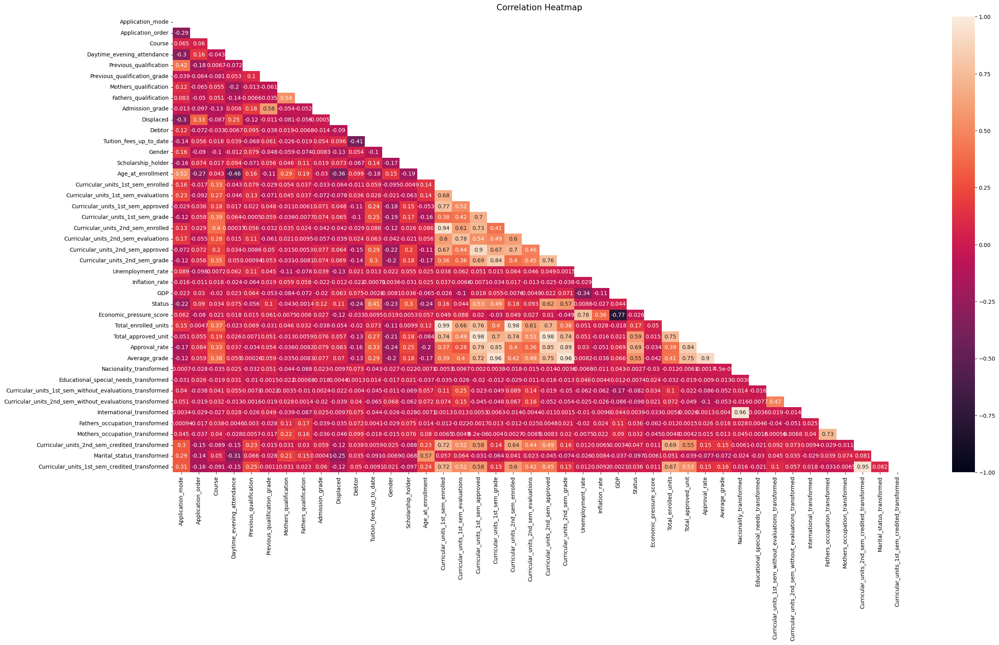

In [23]:
def corr_plot(df, metode):
  plt.figure(figsize=(30,15))
  triangle = np.triu(np.ones_like(df.corr(method = metode)))
  heatmap = sns.heatmap(df.corr(), vmin=-1, vmax=1, annot=True, mask = triangle)
  heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':15}, pad=12)
  return heatmap

numerical_cols = df_cleaned.select_dtypes(include='number').columns
corr_plot(df_cleaned[numerical_cols], "spearman");

Dari grafik heatmap diatas, ternyata hanya ada beberapa fitur-fitur atau kolom berikut ini yang bisa menjadi kandidat penting dalam model karena memiliki skor korelasi yang cukup tinggi:

- `Approval_rate` karena memiliki korelasi yang cukup tinggi dengan kolom target `Status` yaitu sekitar `0.69`.
- `Curricular_units_2nd_sem_approved` karena memiliki korelasi yang cukup tinggi dengan kolom target `Status` yaitu sekitar `0.62`.
- `Total_approved_unit` karena memiliki korelasi yang cukup tinggi dengan kolom target `Status` yaitu sekitar `0.59`.
- `Curricular_units_2nd_sem_grade` karena memiliki korelasi yang cukup tinggi dengan kolom target `Status` yaitu sekitar `0.57`.
- `Average_grade` karena memiliki korelasi yang cukup tinggi dengan kolom target `Status` yaitu sekitar `0.55`.
- `Curricular_units_1st_sem_approved` karena memiliki korelasi yang cukup tinggi dengan kolom target `Status` yaitu sekitar `0.53`.
- `Curricular_units_1st_sem_grade` karena memiliki korelasi yang cukup tinggi dengan kolom target `Status` yaitu sekitar `0.49`.
- `Tuition_fees_up_to_date` karena memiliki korelasi yang cukup tinggi dengan kolom target `Status` yaitu sekitar `0.41`.
- `Scholarship_holder` karena memiliki korelasi yang cukup tinggi dengan kolom target `Status` yaitu sekitar `0.3`.
- `Age_at_enrollment` karena memiliki korelasi yang cukup tinggi dengan kolom target `Status` yaitu sekitar `-0.24`.
- `Gender` karena memiliki korelasi yang cukup tinggi dengan kolom target `Status` yaitu sekitar `-0.23`.
- `Debtor` karena memiliki korelasi yang cukup tinggi dengan kolom target `Status` yaitu sekitar `-0.24`.
- `Application_mode` karena memiliki korelasi yang cukup tinggi dengan kolom target `Status` yaitu sekitar `-0.22`.
- `Curricular_units_2nd_sem_enrolled` karena memiliki korelasi yang cukup tinggi dengan kolom target `Status` yaitu sekitar `0.18`.
- `Total_enrolled_units` karena memiliki korelasi yang cukup tinggi dengan kolom target `Status` yaitu sekitar `0.17`.
- `Curricular_units_1st_sem_enrolled` karena memiliki korelasi yang cukup tinggi dengan kolom target `Status` yaitu sekitar `0.16`.
- `Admission_grade` karena memiliki korelasi yang cukup tinggi dengan kolom target `Status` yaitu sekitar `0.12`.
- `Displaced` karena memiliki korelasi yang cukup tinggi dengan kolom target `Status` yaitu sekitar `0.11`.
- `Previous_qualification_grade` karena memiliki korelasi yang cukup tinggi dengan kolom target `Status` yaitu sekitar `0.1`.

Kolom diatas adalah fitur-fitur yang akan kita gunakan untuk pemodelan klasifikasi memprediksi dropout dan keberhasilan akademik mahasiswa


In [24]:
# Memisahkan fitur (X) dan target (y) dengan fitur (X) yang sudah ditetapkan sebelumnya
feature_x= ['Application_mode', 'Debtor', 'Tuition_fees_up_to_date', 'Gender', 'Scholarship_holder', 'Age_at_enrollment', 'Previous_qualification_grade',
            'Admission_grade', 'Displaced', 'Curricular_units_1st_sem_enrolled', 'Curricular_units_1st_sem_approved', 'Curricular_units_1st_sem_grade',
            'Curricular_units_2nd_sem_enrolled', 'Curricular_units_2nd_sem_approved', 'Curricular_units_2nd_sem_grade', 'Total_enrolled_units',
            'Total_approved_unit', 'Approval_rate', 'Average_grade']
X = df_cleaned[feature_x]
y = df_cleaned['Status']

# Inisialisasi StandardScaler untuk standarisasi data numerikal
scaler = StandardScaler()

#   Menerapkan scaling pada kolom numerikal
X_scaled = scaler.fit_transform(X)

# Mengonversi array numpy kembali ke DataFrame pandas
X_scaled = pd.DataFrame(X_scaled, columns=X.columns, index=X.index)

print("Hasil scaling kolom numerikal:")
X_scaled.head()

Hasil scaling kolom numerikal:


,Application_mode,Debtor,Tuition_fees_up_to_date,Gender,Scholarship_holder,Age_at_enrollment,Previous_qualification_grade,Admission_grade,Displaced,Curricular_units_1st_sem_enrolled,Curricular_units_1st_sem_approved,Curricular_units_1st_sem_grade,Curricular_units_2nd_sem_enrolled,Curricular_units_2nd_sem_approved,Curricular_units_2nd_sem_grade,Total_enrolled_units,Total_approved_unit,Approval_rate,Average_grade
0,-0.095470,-0.358167,0.368135,1.357640,-0.574914,-0.430363,-0.804841,0.022229,0.907512,-2.528560,-1.521257,-2.197102,-2.838337,-1.471527,-1.963489,-2.713086,-1.533977,-1.876398,-2.165950
1,-0.209869,-0.358167,-2.716392,1.357640,-0.574914,-0.562168,2.076819,1.071926,0.907512,-0.109105,0.418050,0.693599,-0.105726,0.518904,0.659562,-0.109088,0.479467,0.886766,0.705237
2,-1.010660,-0.358167,-2.716392,1.357640,-0.574914,-0.562168,-0.804841,-0.150419,0.907512,-0.109105,-1.521257,-2.197102,-0.105726,-1.471527,-1.963489,-0.109088,-1.533977,-1.876398,-2.165950
3,-0.095470,-0.358167,0.368135,-0.736572,-0.574914,-0.430363,-0.804841,-0.509526,0.907512,-0.109105,0.418050,0.575611,-0.105726,0.187165,0.416450,-0.109088,0.311680,0.656503,0.514483
4,1.162916,-0.358167,0.368135,-0.736572,-0.574914,2.864765,-2.473171,1.002867,-1.101914,-0.109105,0.094832,0.349468,-0.105726,0.518904,0.531608,-0.109088,0.311680,0.656503,0.463088


In [25]:
# Memisahkan data menjadi training dan testing
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Menggunakan SMOTE pada data training untuk menangani imbalance
smote = SMOTE(random_state=42)
X_res, y_res = smote.fit_resample(X_train, y_train)

print("Distribusi target setelah oversampling:")
print(pd.Series(y_res).value_counts())

Distribusi target setelah oversampling:
Status
0    1791
1    1791
2    1791
Name: count, dtype: int64


#Modeling

###Logistic Regression

Parameter yang digunakan:

- random_state = 42: Digunakan untuk memastikan hasil model dapat direproduksi dengan memberikan seed yang tetap.
- max_iter = melakukan iterasi dengan maksimal iterasi sebanyak 1000

Dalam implementasi ini, **`LogisticRegression()`** menggunakan semua parameter default dengan penyetelan khusus `random_state` dan `max_iter`. Hasil model diukur dengan menggunakan akurasi train dan test serta confusion matriks.

In [26]:
# Inisialisasi model
log_reg = LogisticRegression(random_state=42, max_iter=1000)

# Melatih model
log_reg.fit(X_res, y_res)

# Prediksi
y_pred_test_lr = log_reg.predict(X_test)
y_pred_train_lr = log_reg.predict(X_res)

# Evaluasi
accuracy_train_lr = accuracy_score(y_pred_train_lr, y_res)
accuracy_test_lr = accuracy_score(y_pred_test_lr, y_test)

print('Logistic Regression - accuracy_train:', accuracy_train_lr)
print('Logistic Regression - accuracy_test:', accuracy_test_lr)
print("Logistic Regression:")
print(confusion_matrix(y_test, y_pred_test_lr))
print(classification_report(y_test, y_pred_test_lr))

Logistic Regression - accuracy_train: 0.7306904894844594
Logistic Regression - accuracy_test: 0.7468926553672316
Logistic Regression:
[[227  60  29]
 [ 28  89  34]
 [ 18  55 345]]
              precision    recall  f1-score   support

           0       0.83      0.72      0.77       316
           1       0.44      0.59      0.50       151
           2       0.85      0.83      0.84       418

    accuracy                           0.75       885
   macro avg       0.70      0.71      0.70       885
weighted avg       0.77      0.75      0.76       885



###Decision Tree Classifier

Parameter yang digunakan:

- random_state = 42: Digunakan untuk memastikan hasil model dapat direproduksi dengan memberikan seed yang tetap.

Dalam implementasi ini, **`DecisionTreeClassifier()`** menggunakan semua parameter default dan penyetelan khusus pada `random_state`. Hasil model diukur dengan menggunakan akurasi train dan test serta confusion matriks.

In [27]:
# Inisialisasi model
dt_classifier = DecisionTreeClassifier(random_state=42)

# Melatih model
dt_classifier.fit(X_res, y_res)

# Prediksi
y_pred_test_dtc = dt_classifier.predict(X_test)
y_pred_train_dtc = dt_classifier.predict(X_res)

# Evaluasi
accuracy_train_dtc = accuracy_score(y_pred_train_dtc, y_res)
accuracy_test_dtc = accuracy_score(y_pred_test_dtc, y_test)

print('Decision Tree Classifier - accuracy_train:', accuracy_train_dtc)
print('Decision Tree Classifier - accuracy_test:', accuracy_test_dtc)
print("Decision Tree Classifier:")
print(confusion_matrix(y_test, y_pred_test_dtc))
print(classification_report(y_test, y_pred_test_dtc))

Decision Tree Classifier - accuracy_train: 1.0
Decision Tree Classifier - accuracy_test: 0.6587570621468927
Decision Tree Classifier:
[[209  71  36]
 [ 46  59  46]
 [ 47  56 315]]
              precision    recall  f1-score   support

           0       0.69      0.66      0.68       316
           1       0.32      0.39      0.35       151
           2       0.79      0.75      0.77       418

    accuracy                           0.66       885
   macro avg       0.60      0.60      0.60       885
weighted avg       0.68      0.66      0.67       885



###SVM

Parameter yang digunakan:

- random_state = 42: Digunakan untuk memastikan hasil model dapat direproduksi dengan memberikan seed yang tetap.
- probability = True: digunakan untuk parameter yang dipelajari dalam
Penskalaan Platt untuk menghasilkan estimasi probabilitas dari nilai keputusan.

Dalam implementasi ini, **`SVM()`** menggunakan semua parameter default dan penyetelan khusus pada `random_state` dan `probability`. Hasil model diukur dengan menggunakan akurasi train dan test serta confusion matriks.

In [28]:
# Inisialisasi model
svm_classifier = SVC(random_state=42, probability=True)

# Melatih model
svm_classifier.fit(X_res, y_res)

# Prediksi
y_pred_test_svm = svm_classifier.predict(X_test)
y_pred_train_svm = svm_classifier.predict(X_res)

# Evaluasi
accuracy_train_svm = accuracy_score(y_pred_train_svm, y_res)
accuracy_test_svm = accuracy_score(y_pred_test_svm, y_test)

print('SVM - accuracy_train:', accuracy_train_svm)
print('SVM - accuracy_test:', accuracy_test_svm)
print("SVM:")
print(confusion_matrix(y_test, y_pred_test_svm))
print(classification_report(y_test, y_pred_test_svm))

SVM - accuracy_train: 0.7746138097896892
SVM - accuracy_test: 0.7367231638418079
SVM:
[[215  67  34]
 [ 21  92  38]
 [ 10  63 345]]
              precision    recall  f1-score   support

           0       0.87      0.68      0.77       316
           1       0.41      0.61      0.49       151
           2       0.83      0.83      0.83       418

    accuracy                           0.74       885
   macro avg       0.71      0.71      0.69       885
weighted avg       0.77      0.74      0.75       885



###Random Forest Classifier

Parameter yang digunakan:

- random_state = 42: Digunakan untuk memastikan hasil model dapat direproduksi dengan memberikan seed yang tetap.

Dalam implementasi ini, **`RandomForestClassifier()`** menggunakan semua parameter default dan penyetelan khusus pada `random_state`. Hasil model diukur dengan menggunakan akurasi train dan test serta confusion matriks.

In [29]:
# Inisialisasi model
rf_classifier = RandomForestClassifier(random_state=42)

# Melatih model
rf_classifier.fit(X_res, y_res)

# Prediksi
y_pred_test_rfc = rf_classifier.predict(X_test)
y_pred_train_rfc = rf_classifier.predict(X_res)

# Evaluasi
accuracy_train_rfc = accuracy_score(y_pred_train_rfc, y_res)
accuracy_test_rfc = accuracy_score(y_pred_test_rfc, y_test)

print('Random Forest Classifier - accuracy_train:', accuracy_train_rfc)
print('Random Forest Classifier - accuracy_test:', accuracy_test_rfc)
print("Random Forest Classifier:")
print(confusion_matrix(y_test, y_pred_test_rfc))
print(classification_report(y_test, y_pred_test_rfc))

Random Forest Classifier - accuracy_train: 1.0
Random Forest Classifier - accuracy_test: 0.7593220338983051
Random Forest Classifier:
[[235  40  41]
 [ 32  67  52]
 [ 12  36 370]]
              precision    recall  f1-score   support

           0       0.84      0.74      0.79       316
           1       0.47      0.44      0.46       151
           2       0.80      0.89      0.84       418

    accuracy                           0.76       885
   macro avg       0.70      0.69      0.70       885
weighted avg       0.76      0.76      0.76       885



#### Hyperparameter Tuning Using Random Forest Classifier

Pada tahapan hyperparameter tuning ini kita mencari kombinasi parameter yang paling optimal untuk model machine learning yang kita guna meningkatkan performanya. Pada tahapan ini kita mencoba mencari parameter yang cocok dengan parameter yang dituning adalah `n_estimators` (50, 100, 200), `max_depth` (10, 20, None), `min_sample_split` (2, 5, 10), `max_features` (None, sqrt, log2)

In [30]:
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [10, 20, None],
    'min_samples_split': [2, 5, 10],
    'max_features': [None, 'sqrt', 'log2']
}

grid_search = GridSearchCV(estimator=rf_classifier, param_grid=param_grid, cv=3, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_res, y_res)

best_rf_model = grid_search.best_estimator_
print("Best Random Forest Accuracy Train:", grid_search.best_score_)

y_pred = best_rf_model.predict(X_test)
test_accuracy = accuracy_score(y_test, y_pred)

print("Best Random Forest Accuracy Test:", test_accuracy)

Best Random Forest Accuracy Train: 0.8217010980830075
Best Random Forest Accuracy Test: 0.7536723163841808


## Finding Feature Importance

Mencari fitur mana yang paling penting untuk menunjukkan atau menentukan seberapa besar pengaruh atau kontribusi setiap fitur (variabel independen) dalam menentukan prediksi model.

In [31]:
# Melihat feature importance menggunakan Random Forest Classifier
feature_importance = pd.DataFrame({
    'Feature': X_res.columns,
    'Importance': rf_classifier.feature_importances_
}).sort_values(by='Importance', ascending=False)

print(feature_importance)

                              Feature  Importance
17                      Approval_rate    0.153791
13  Curricular_units_2nd_sem_approved    0.109506
14     Curricular_units_2nd_sem_grade    0.078287
16                Total_approved_unit    0.078131
18                      Average_grade    0.076851
7                     Admission_grade    0.063859
11     Curricular_units_1st_sem_grade    0.060109
5                   Age_at_enrollment    0.059625
6        Previous_qualification_grade    0.058765
10  Curricular_units_1st_sem_approved    0.046816
2             Tuition_fees_up_to_date    0.037377
0                    Application_mode    0.036488
15               Total_enrolled_units    0.029457
12  Curricular_units_2nd_sem_enrolled    0.026688
9   Curricular_units_1st_sem_enrolled    0.025383
4                  Scholarship_holder    0.017503
3                              Gender    0.015098
8                           Displaced    0.013528
1                              Debtor    0.012739


Dapat dilihat top 3 feature importancenya yaitu kolom `Approval_rate` `Curricular_units_2nd_sem_approved`, dan `Curricular_units_2nd_sem_grade`

## Neural Network

Disini saya mencoba untuk menggunakan pemodelan neural network karna hasil dari beberapa model machine learning yang dilatih itu akurasi yang paling bagus hanya sebesar 75%, untuk itu saya mencoba dengan menggunakan neural network

In [32]:
model = Sequential()

# Input layer
model.add(Dense(16, activation='relu', input_shape=(X_res.shape[1],)))

# Hidden layers
model.add(Dense(32, activation='relu'))

# Output layer (3 classes for Dropout, Graduate, Enrolled)
model.add(Dense(3, activation='softmax'))

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [33]:
history = model.fit(X_res, y_res, epochs=50, batch_size=32, validation_data=(X_test, y_test))

Epoch 1/50
168/168 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.4582 - loss: 1.0142 - val_accuracy: 0.7062 - val_loss: 0.7015
Epoch 2/50
168/168 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - accuracy: 0.6756 - loss: 0.7474 - val_accuracy: 0.7322 - val_loss: 0.6412
Epoch 3/50
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7120 - loss: 0.6844 - val_accuracy: 0.7356 - val_loss: 0.6474
Epoch 4/50
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7262 - loss: 0.6485 - val_accuracy: 0.7356 - val_loss: 0.6482
Epoch 5/50
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7220 - loss: 0.6479 - val_accuracy: 0.7390 - val_loss: 0.6471
Epoch 6/50
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7446 - loss: 0.6211 - val_accuracy: 0.7345 - val_loss: 0.6445
Epoch 7/50
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7337 - loss: 0.6319 - val_accuracy: 0.7412 - val_loss: 0.6495
Epoch 8/50
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7412 - loss: 0.6154 - val_accuracy: 0

In [34]:
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print(f"Test Accuracy: {test_accuracy}")

28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7175 - loss: 0.7323
Test Accuracy: 0.7231638431549072


Ternyata hasilnya lebih rendah dari mechine learning sebelumnya terutama pada model `Random Forest (Hyperparameter Tuning)`, dengan hasil akurasi test yang didapat hanya sebesar 73% saja.

# Insight Model

1. **Kelas yang Sulit Diprediksi**:
Kelas 1 (Enrolled) memiliki nilai precision dan recall yang lebih rendah dibandingkan kelas lainnya. Ini menunjukkan bahwa model kesulitan untuk memprediksi siswa yang terdaftar.

2. **Feature Importance**:
Beberapa fitur yang paling berpengaruh pada model Random Forest (model terbaik) adalah: **`Approval_rate (15.37)`**, **`Curricular_units_2nd_sem_approved (10.95%)`**, &**`Curricular_units_2nd_sem_grade (7.82%)`**
Hal ini menunjukkan pentingnya pelacakan dan nilai dari unit kurikulum yang diambil siswa untuk menentukan status mereka.

3. **Model Terbaik untuk Deployment**: **`Random Forest`** menjadi salah satu model yang paling baik untuk diimplementasikan lebih lanjut, dengan akurasi test sebesar **75.93%**. Hasil akurasi test yang tinggi menunjukkan bahwa model ini dapat menghasilkan prediksi yang lebih baik dibandingkan dengan model lainnya.

4. **Performa Model**
- **Logistic Regression** menunjukkan performa test yang cukup stabil (74.68%) dengan ketidaksesuaian yang kecil antara train dan test, menunjukkan generalisasi yang cukup baik.

- **Decision Tree** mengalami overfitting berat (train 100%, test 65.87%), sehingga kurang disarankan untuk deployment.

- **SVM** menghasilkan akurasi test sebesar 73.67%, namun tetap struggle di kelas "Enrolled" (precision rendah).

- **Random Forest** memiliki performa lebih stabil dan kuat (akurasi test 75.93%), mengurangi overfitting dibanding Decision Tree.

- **Neural Network** menunjukkan akurasi test sebesar 72.31%, yang mana tidak membuat modelnya lebih baik dari model RandomForest

# Saved Model

In [35]:
# Simpan model Random Forest
joblib.dump(rf_classifier, 'random_forest_model.pkl')

['random_forest_model.pkl']

# Conclusion

Tujuan utama proyek ini adalah membangun model klasifikasi untuk memprediksi dropout, terdaftar dan keberhasilan akademik mahasiswa berdasarkan data demografi dan kinerja awal mereka. Berdasarkan hasil dari beberapa model, seperti Random Forest, Logistic Regression, Decision Tree, dan Neural Networks, kita telah mencapai pemodelan yang cukup baik dengan akurasi yang bervariasi. Hasil terbaik dicapai oleh model  **Random Forest Classifier** dengan akurasi test **75.93%**, yang menunjukkan bahwa model dapat memprediksi dropout dan keberhasilan akademik mahasiswa dengan baik, namun dalam memprediksi terdaftar sedikit kurang bagus. Dengan faktor-faktor yang paling berpengaruh terhadap prediksi dropout, terdaftar dan keberhasilan akademik adalah `Approval_rate (15.37)`, `Curricular_units_2nd_sem_approved (10.95%)`, &`Curricular_units_2nd_sem_grade (7.82%)`. Faktor-faktor ini menunjukkan pentingnya performa akademik di semester awal dalam menentukan keberhasilan, terdaftar ataupun dropout.